<a href="https://colab.research.google.com/github/jacobwmorgan/champignons/blob/main/com_ml_and_dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Mushroom Classification Using Machine Learning

# Installing and Mounting G-Drive and GPU Handling

In [2]:
%pip install opencv-python -q
%pip install matplotlib -q
%pip install tqdm -q
%pip install -U scikit-learn -q
%pip install -q tensorflow
%pip install pandas -q
%pip install visualkeras -q



     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 993.0/993.0 kB 51.6 MB/s eta 0:00:00


In [3]:
from google.colab import drive
drive.mount('/content/drive',force_remount = True)

Mounted at /content/drive


In [4]:
import numpy as np
import matplotlib.pyplot as plt 
import os 
import cv2 
from tqdm import tqdm
import PIL
import PIL.Image
import tensorflow as tf
import tensorflow_datasets as tfds
import datetime
import pandas as pd
import visualkeras

In [5]:
from tensorflow.python.client import device_lib
from tensorflow.keras.callbacks import TensorBoard
print(device_lib.list_local_devices())
if tf.test.gpu_device_name():
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))
else:
    print("Please install GPU version of TF")
    
gpus = tf.config.list_physical_devices('GPU')
if gpus:
  # Restrict TensorFlow to only use the first GPU
  try:
    tf.config.set_visible_devices(gpus[0], 'GPU')
    logical_gpus = tf.config.list_logical_devices('GPU')
    print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPU")
  except RuntimeError as e:
    # Visible devices must be set before GPUs have been initialized
    print(e)

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 11364788162256434667
xla_global_id: -1
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 14343274496
locality {
  bus_id: 1
  links {
  }
}
incarnation: 7908585742923475003
physical_device_desc: "device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5"
xla_global_id: 416903419
]
Default GPU Device: /device:GPU:0
1 Physical GPUs, 1 Logical GPU


In [6]:
!nvidia-smi

Wed May 10 11:59:00 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   35C    P0    26W /  70W |    373MiB / 15360MiB |      2%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [7]:
tf.test.gpu_device_name()

'/device:GPU:0'

# Dataset Handling

### Loading Dataset

In [8]:
#"""
#import pathlib
#dataset_url = "https://www.kaggle.com/datasets/maysee/mushrooms-classification-common-genuss-images"
#archiv = tf.keras.utils.get_file(origin = dataset_url, extract = True)
#data_dir = pathlib.Path(archiv).with_suffix('')
#"""

Change the directory here to where the dataset is

Use [this](https://www.kaggle.com/datasets/maysee/mushrooms-classification-common-genuss-images) dataset


In [9]:
import pathlib
import random


#Storing the path of the dataset as a string
DATADIR = "/content/drive/MyDrive/Mushrooms/dataset" 

#Converting this string into a Path class
data_dir = pathlib.Path(DATADIR).with_suffix('')

#Gets how many images there are in the dataset
image_count = len(list(data_dir.glob('*/*.jpg')))


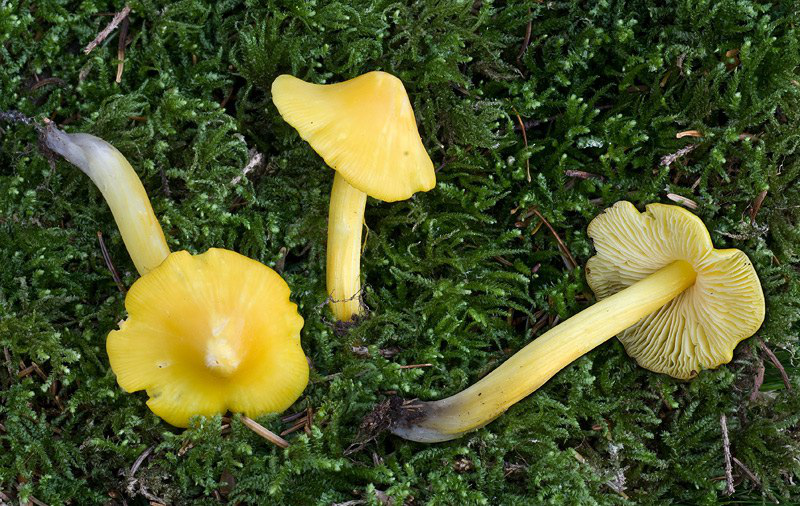

Numer of Images in dataset : 6711
Number of Categories : 9
['Hygrocybe', 'Agaricus', 'Boletus', 'Russula', 'Amanita', 'Suillus', 'Cortinarius', 'Entoloma', 'Lactarius']


In [10]:

categories = list()
for root,dirs,files in os.walk(DATADIR,topdown=False):
    #print(dirs)
    for name in dirs:
        categories.append(name)

agaricus = list(data_dir.glob(f'{categories[0]}/*'))
random_agaricus = random.randint(0,len(agaricus)-1)
PIL.Image.open(str(agaricus[random_agaricus])).show()
number_of_classes = len(categories)
print("Numer of Images in dataset :",image_count)
print("Number of Categories :",len(categories))
print(categories)

### Debugging Images 
[Script found here](https://github.com/tensorflow/tpu/issues/455)

In [11]:
from struct import unpack
import os
marker_mapping = {
    0xffd8: "Start of Image",
    0xffe0: "Application Default Header",
    0xffdb: "Quantization Table",
    0xffc0: "Start of Frame",
    0xffc4: "Define Huffman Table",
    0xffda: "Start of Scan",
    0xffd9: "End of Image"
}
class JPEG:
  def __init__(self, image_file):
    with open(image_file, 'rb') as f:
      self.img_data = f.read()

  def decode(self):
    data = self.img_data
    while(True):
      marker, = unpack(">H", data[0:2])
      # print(marker_mapping.get(marker))
      if marker == 0xffd8:
        data = data[2:]
      elif marker == 0xffd9:
        return
      elif marker == 0xffda:
        data = data[-2:]
      else:
        lenchunk, = unpack(">H", data[2:4])
        data = data[2+lenchunk:]            
      if len(data)==0:
        raise TypeError("issue reading jpeg file")  

     
bads = []
for category in categories: 
  path = os.path.join(data_dir,category)
  for img  in tqdm(os.listdir(path)):
    imagedir = os.path.join(path,img)
    image = JPEG(imagedir) 
    try:
      image.decode()   
    except:
      bads.append(imagedir)

print(f"\n Bad Images -> {bads}")

for name in bads:
  os.remove(name)



100%|██████████| 1563/1563 [00:35<00:00, 43.93it/s] 


 Bad Images -> []


### Creating Dataset

In [12]:
img_height = 200
img_width = 200

training_ds = tf.keras.utils.image_dataset_from_directory(
    data_dir,
    labels = "inferred",
    label_mode = "categorical",
    color_mode = "rgb",
    validation_split = 0.33,
    subset = "training",
    shuffle = True,
    seed = 555,
    batch_size=32,
    image_size = (img_height, img_width),
    class_names = categories
)

Found 6711 files belonging to 9 classes.
Using 4497 files for training.


In [13]:
validation_ds = tf.keras.utils.image_dataset_from_directory(
    data_dir,
    labels = "inferred",
    label_mode = "categorical",
    color_mode = "rgb",
    validation_split = 0.33,
    subset = "validation",
    shuffle = True,
    seed = 555,
    batch_size=32,
    image_size = (img_height, img_width),
    class_names = categories

)

Found 6711 files belonging to 9 classes.
Using 2214 files for validation.


In [14]:
class_names = training_ds.class_names
print(class_names)

['Hygrocybe', 'Agaricus', 'Boletus', 'Russula', 'Amanita', 'Suillus', 'Cortinarius', 'Entoloma', 'Lactarius']


In [15]:
AUTOTUNE = tf.data.AUTOTUNE
train_ds = training_ds.cache().prefetch(buffer_size = AUTOTUNE)
validation_ds = validation_ds.cache().prefetch(buffer_size = AUTOTUNE)

### Data Visualisation

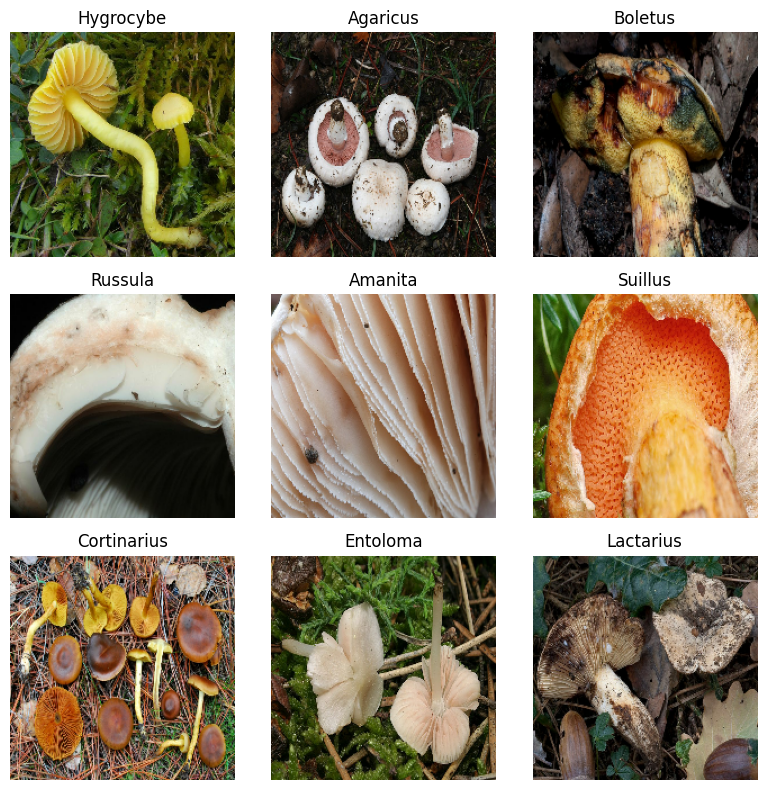

In [16]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(8,8))
axes = axes.flatten()


# Loop over each class and get the first image in the training dataset for that class
for class_name in class_names:
    found_image = False
    for images, labels in training_ds:
        for i, label in enumerate(labels):
            index = class_names.index(class_name)
            if tf.argmax(label).numpy() == class_names.index(class_name):
                image = images[i].numpy().astype("uint8")
                axes[index].imshow(image)
                axes[index].set_title(class_name)
                axes[index].axis("off")
                found_image = True
                break
        if found_image:
            break
    if not found_image:
        print(f"No images found for class {class_name}")

plt.tight_layout()
plt.show()

In [17]:
image_shape = []
for image_batch, labels_batch in training_ds:
  image_shape = image_batch.shape
  print(image_batch.shape)
  print(labels_batch.shape)
  break


(32, 200, 200, 3)
(32, 9)


In [18]:
def class_count(dataset):
  class_counts = {}
  for images, labels in dataset:
      class_indices = tf.argmax(labels, axis=1).numpy()
      for i in range(len(class_indices)):
          class_name = class_names[class_indices[i]]
          if class_name in class_counts:
              class_counts[class_name] += 1
          else:
              class_counts[class_name] = 1
  return class_counts

In [19]:


counted_training = class_count(training_ds)
counted_validation = class_count(validation_ds)
counted_total = {"training":0,"validation":0}




print("Class Counts:")
for class_name in counted_training:
    print(f"{class_name}: Training - {counted_training[class_name]} | Validation - {counted_validation[class_name]}")
    counted_total["training"] += counted_training[class_name]
    counted_total["validation"] += counted_validation[class_name]

print(f"Training Total:{counted_total['training']} \nValidation Total:{counted_total['validation']}")

Class Counts:
Lactarius: Training - 1037 | Validation - 526
Hygrocybe: Training - 209 | Validation - 107
Amanita: Training - 511 | Validation - 239
Boletus: Training - 713 | Validation - 360
Entoloma: Training - 243 | Validation - 121
Russula: Training - 772 | Validation - 373
Agaricus: Training - 241 | Validation - 112
Cortinarius: Training - 556 | Validation - 280
Suillus: Training - 215 | Validation - 96
Training Total:4497 
Validation Total:2214



# Models & Training

## Call backs


In [22]:
early_stop = tf.keras.callbacks.EarlyStopping(monitor = "val_accuracy",
                                              patience = 5,
                                              restore_best_weights = True)

reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(monitor = "val_loss",
                                                 factor = 0.2,
                                                 mode = "auto",
                                                 patience = 5,
                                                 min_lr = 0.001,
                                                 cooldown = 0)

## Champignon-net
My model

### Making champignon-net model

In [ ]:
%pip install -q -U keras-tuner


In [ ]:

from tensorflow.keras.layers import Rescaling, Conv2D , MaxPooling2D , Flatten, Dense, Dropout, BatchNormalization ,Activation
from tensorflow.keras.losses import categorical_crossentropy
from tensorflow.keras.optimizers import Adam

img_height, img_width = 200,200

model = tf.keras.Sequential([
  Conv2D(256,(3,3),input_shape=(img_height, img_width, 3)),
  BatchNormalization(),
  Activation("relu"),
  MaxPooling2D(pool_size =(2,2)),

  Conv2D(128,(3,3)),
  BatchNormalization(),
  Activation("relu"),
  MaxPooling2D(pool_size =(2,2)),



  Conv2D(64,(3,3)),
  BatchNormalization(),
  Activation("relu"),
  MaxPooling2D(pool_size =(2,2)),


  Conv2D(32,(3,3)),
  BatchNormalization(),
  Activation("relu"),
  MaxPooling2D(pool_size =(2,2)),

  Conv2D(16,(3,3)),
  BatchNormalization(),
  Activation("relu"),
  MaxPooling2D(pool_size =(2,2)),



  Flatten(),
  Dense(128, activation='relu'),
  Dropout(0.5),
  Dense(number_of_classes,activation = 'softmax')

])


model.build(input_shape = (image_shape[1],image_shape[2],image_shape[3]))

model.compile(
  optimizer = Adam(learning_rate=0.001),
  loss = categorical_crossentropy,
  metrics=['accuracy']
)

model.summary()
print(number_of_classes)

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_5 (Conv2D)           (None, 198, 198, 256)     7168      
                                                                 
 batch_normalization_5 (Batc  (None, 198, 198, 256)    1024      
 hNormalization)                                                 
                                                                 
 activation_5 (Activation)   (None, 198, 198, 256)     0         
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 99, 99, 256)      0         
 2D)                                                             
                                                                 
 conv2d_6 (Conv2D)           (None, 97, 97, 128)       295040    
                                                                 
 batch_normalization_6 (Batc  (None, 97, 97, 128)     

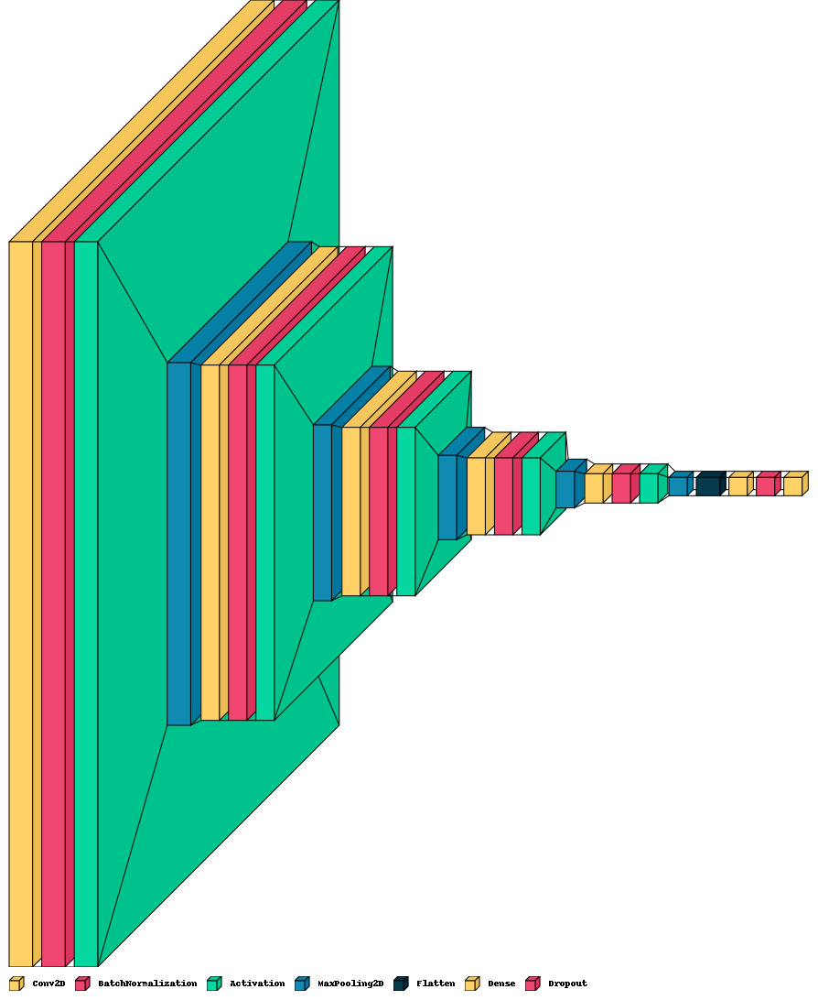

In [ ]:
visualkeras.layered_view(model, legend=True)

### Tuning champignon-net

In [ ]:
from tensorflow import keras
from kerastuner import HyperParameters
from kerastuner.tuners import RandomSearch
img_height = 200
img_width = 200



def champignon_model(hp):
  model = keras.Sequential()
  model.add(Conv2D(hp.Choice('num_filters_1', [128,256]),(3,3),input_shape=(img_height, img_width, 3)))
  model.add(BatchNormalization())
  model.add(Activation('relu'))
  model.add(MaxPooling2D(pool_size=(2, 2)))

  model.add(Conv2D(hp.Choice('num_filters_2', [64,128]),(3,3)))
  model.add(BatchNormalization())
  model.add(Activation('relu'))
  model.add(MaxPooling2D(pool_size=(2, 2)))
  
  model.add(Conv2D(hp.Choice('num_filters_3', [32,64]),(3,3)))
  model.add(BatchNormalization())
  model.add(Activation('relu'))
  model.add(MaxPooling2D(pool_size=(2, 2)))

  model.add(Conv2D(hp.Choice('num_filters_4', [16,32]),(3,3)))
  model.add(BatchNormalization())
  model.add(Activation('relu'))
  model.add(MaxPooling2D(pool_size=(2, 2)))

  model.add(Conv2D(hp.Choice('num_filters_5', [8,16]),(3,3)))
  model.add(BatchNormalization())
  model.add(Activation('relu'))
  model.add(MaxPooling2D(pool_size=(2, 2)))

  # Add fully connected layers
  model.add(Flatten())
  model.add(Dense(hp.Choice('hidden_units', [64, 128, 256]), activation='relu'))
  model.add(Dropout(hp.Float('dropout', 0, 0.55, step=0.1)))
  model.add(Dense(number_of_classes, activation='softmax'))


  model.build(input_shape = (image_shape[1],image_shape[2],image_shape[3]))
  # Compile the model
  model.compile(
      optimizer=keras.optimizers.Adam(
          hp.Choice('learning_rate', [1e-2, 1e-3, 1e-4])),
      loss='categorical_crossentropy', 
      metrics=['accuracy'])
  return model


<ipython-input-23-b31c8a84731c>:2: DeprecationWarning: `import kerastuner` is deprecated, please use `import keras_tuner`.
  from kerastuner import HyperParameters


Trial 10 Complete [00h 10m 35s]
val_accuracy: 0.5207768678665161

Best val_accuracy So Far: 0.5207768678665161
Total elapsed time: 01h 29m 51s


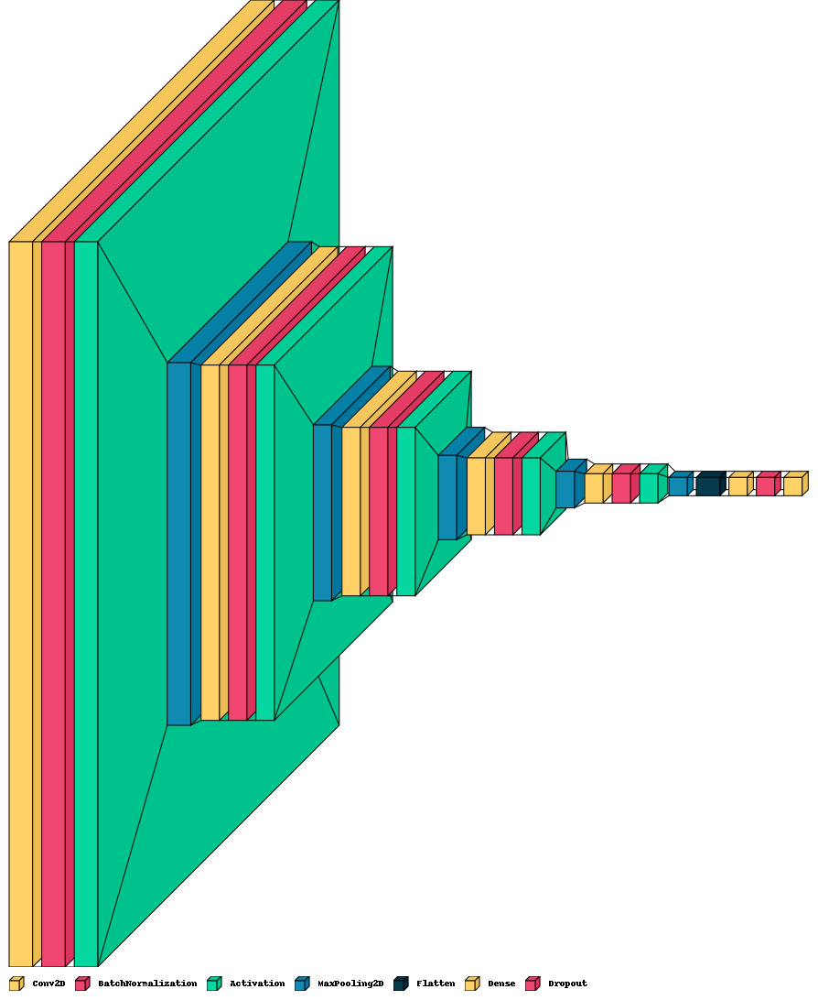

In [ ]:
# Define the tuner
tuner = RandomSearch(
    champignon_model,
    objective='val_accuracy',
    max_trials=10,
    directory='tuner_dir',
    project_name='champignon_model_15')

# Start the search for the best hyperparameters
tuner.search(training_ds,
             epochs=25,
             validation_data=validation_ds)

best_model = tuner.get_best_models(num_models=1)[0]
best_hyperparameters = tuner.get_best_hyperparameters(num_trials=1)[0]
visualkeras.layered_view(best_model, legend=True) # Visualisation of model

### Training champignon-net

In [ ]:
NAME = f"champignon-net-{number_of_classes}-{datetime.datetime.now().strftime('%Y%m%d-%H%M%S')}"
tensorboard = TensorBoard(log_dir = f"drive/MyDrive/Champignons/logs/{NAME}")

In [ ]:
model.fit(training_ds,validation_data = validation_ds,epochs =50, callbacks = [early_stop, reduce_lr,tensorboard],use_multiprocessing = True)

Epoch 1/50
141/141 [==============================] - 17s 111ms/step - loss: 1.3813 - accuracy: 0.5074 - val_loss: 1.5497 - val_accuracy: 0.4756 - lr: 0.0010
Epoch 2/50
141/141 [==============================] - 16s 111ms/step - loss: 1.3244 - accuracy: 0.5301 - val_loss: 1.5723 - val_accuracy: 0.4548 - lr: 0.0010
Epoch 3/50
141/141 [==============================] - 16s 112ms/step - loss: 1.2656 - accuracy: 0.5453 - val_loss: 1.8756 - val_accuracy: 0.3749 - lr: 0.0010
Epoch 4/50
141/141 [==============================] - 17s 111ms/step - loss: 1.2522 - accuracy: 0.5602 - val_loss: 1.5970 - val_accuracy: 0.4603 - lr: 0.0010
Epoch 5/50
141/141 [==============================] - 16s 110ms/step - loss: 1.2009 - accuracy: 0.5768 - val_loss: 2.4225 - val_accuracy: 0.3451 - lr: 0.0010
Epoch 6/50
141/141 [==============================] - 16s 111ms/step - loss: 1.1633 - accuracy: 0.5868 - val_loss: 1.6170 - val_accuracy: 0.4783 - lr: 0.0010
Epoch 7/50
141/141 [==============================] 

In [ ]:
model.evaluate(validation_ds,verbose = 1)

70/70 [==============================] - 2s 28ms/step - loss: 1.6435 - accuracy: 0.5154


[1.6435458660125732, 0.5153568387031555]

In [ ]:
history_frame  = pd.DataFrame(model.history)

history_frame.loc[:, ['accuracy', 'val_accuracy']].plot();
history_frame.loc[:, ['loss', 'val_loss']].plot();

In [ ]:
NAME = f"champignon-net-best-{number_of_classes}-{datetime.datetime.now().strftime('%Y%m%d-%H%M%S')}"
tensorboard = TensorBoard(log_dir = f"drive/MyDrive/Champignons/logs/{NAME}")

champignon_model_2 = champignon_model(best_hyperparameters)
history = champignon_model_2.fit(training_ds,validation_data = validation_ds,epochs =50, callbacks = [early_stop, reduce_lr,tensorboard],use_multiprocessing = True)

Epoch 1/50
141/141 [==============================] - 20s 106ms/step - loss: 2.0495 - accuracy: 0.2595 - val_loss: 2.5605 - val_accuracy: 0.2584 - lr: 0.0010
Epoch 2/50
141/141 [==============================] - 15s 104ms/step - loss: 1.8613 - accuracy: 0.3200 - val_loss: 1.8986 - val_accuracy: 0.3112 - lr: 0.0010
Epoch 3/50
141/141 [==============================] - 16s 107ms/step - loss: 1.7614 - accuracy: 0.3565 - val_loss: 2.1979 - val_accuracy: 0.2534 - lr: 0.0010
Epoch 4/50
141/141 [==============================] - 16s 107ms/step - loss: 1.6803 - accuracy: 0.3887 - val_loss: 2.6905 - val_accuracy: 0.1888 - lr: 0.0010
Epoch 5/50
141/141 [==============================] - 16s 106ms/step - loss: 1.6170 - accuracy: 0.4109 - val_loss: 1.8384 - val_accuracy: 0.3699 - lr: 0.0010
Epoch 6/50
141/141 [==============================] - 16s 106ms/step - loss: 1.5626 - accuracy: 0.4352 - val_loss: 1.9648 - val_accuracy: 0.2972 - lr: 0.0010
Epoch 7/50
141/141 [==============================] 

In [ ]:
champignon_model_2.evaluate(validation_ds,verbose=1)

70/70 [==============================] - 2s 27ms/step - loss: 1.6857 - accuracy: 0.4892


[1.6856552362442017, 0.48915988206863403]

## Efficient-net

Found [here](https://www.tensorflow.org/api_docs/python/tf/keras/applications/efficientnet)  
Paper -> https://arxiv.org/abs/1905.11946

### Making Efficient-net Model 


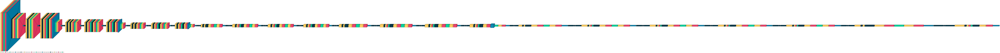

In [26]:
eff_model = tf.keras.applications.EfficientNetB1(weights = "imagenet",
                                                 include_top = False,
                                                 input_shape = (img_height, img_width,3),
                                                 pooling = "avg")

visualkeras.layered_view(eff_model, legend= True)

In [24]:



eff_model = tf.keras.models.Sequential(
    [
        eff_model,
        tf.keras.layers.Dense(number_of_classes,activation = "softmax")
    ]
)
eff_model.layers[0].trainable = False
eff_model.compile(loss = "categorical_crossentropy",
                  optimizer = "adam",
                  metrics = ["accuracy"])
#eff_model.get_config()
eff_model.summary()


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 efficientnetb1 (Functional)  (None, 1280)             6575239   
                                                                 
 dense (Dense)               (None, 9)                 11529     
                                                                 
Total params: 6,586,768
Trainable params: 11,529
Non-trainable params: 6,575,239
_________________________________________________________________


### Training  Efficient-Net

In [ ]:
NAME = f"efficientnetb1-{number_of_classes}-{datetime.datetime.now().strftime('%Y%m%d-%H%M%S')}"
tensorboard = TensorBoard(log_dir = f"drive/MyDrive/Champignons/logs/{NAME}")

In [ ]:
history = eff_model.fit(training_ds,validation_data = validation_ds,epochs =50, callbacks = [early_stop, reduce_lr,tensorboard],use_multiprocessing = True)

Epoch 1/50
141/141 [==============================] - 19s 64ms/step - loss: 2.1330 - accuracy: 0.1717 - val_loss: 2.0483 - val_accuracy: 0.2290 - lr: 0.0010
Epoch 2/50
141/141 [==============================] - 7s 45ms/step - loss: 1.9556 - accuracy: 0.3785 - val_loss: 1.8931 - val_accuracy: 0.4923 - lr: 0.0010
Epoch 3/50
141/141 [==============================] - 7s 45ms/step - loss: 1.7985 - accuracy: 0.5357 - val_loss: 1.7584 - val_accuracy: 0.5104 - lr: 0.0010
Epoch 4/50
141/141 [==============================] - 7s 44ms/step - loss: 1.6610 - accuracy: 0.5486 - val_loss: 1.6399 - val_accuracy: 0.5212 - lr: 0.0010
Epoch 5/50
141/141 [==============================] - 7s 45ms/step - loss: 1.5392 - accuracy: 0.5842 - val_loss: 1.5347 - val_accuracy: 0.6143 - lr: 0.0010
Epoch 6/50
141/141 [==============================] - 7s 44ms/step - loss: 1.4276 - accuracy: 0.6920 - val_loss: 1.4407 - val_accuracy: 0.6820 - lr: 0.0010
Epoch 7/50
141/141 [==============================] - 7s 46ms/s

In [ ]:
loss,accuracy = eff_model.evaluate(validation_ds,verbose = 1)
print("Performace on test data: \n Loss: {} \n Accuracy: {}".format(loss, accuracy))

70/70 [==============================] - 2s 22ms/step - loss: 0.6716 - accuracy: 0.7995
Performace on test data: 
 Loss: 0.6715725660324097 
 Accuracy: 0.7994579672813416


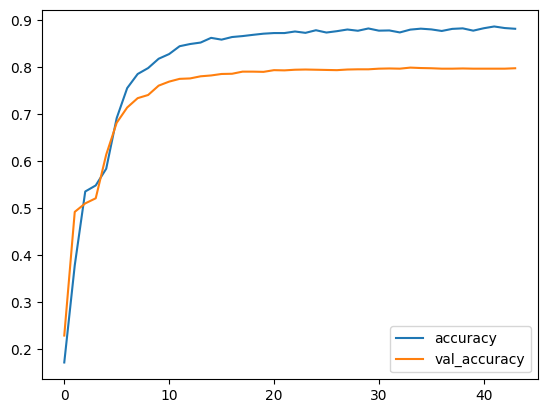

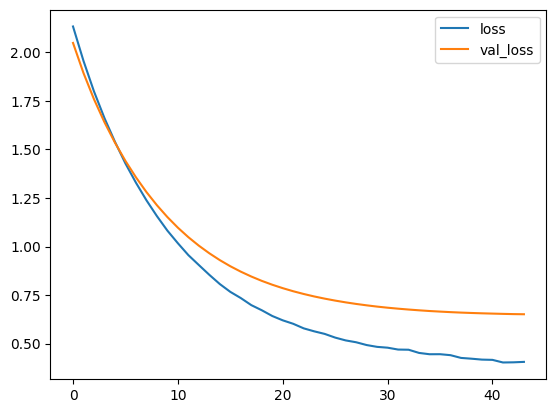

In [ ]:
history_frame  = pd.DataFrame(history.history)

history_frame.loc[:, ['accuracy', 'val_accuracy']].plot();
history_frame.loc[:, ['loss', 'val_loss']].plot();


70/70 [==============================] - 11s 117ms/step


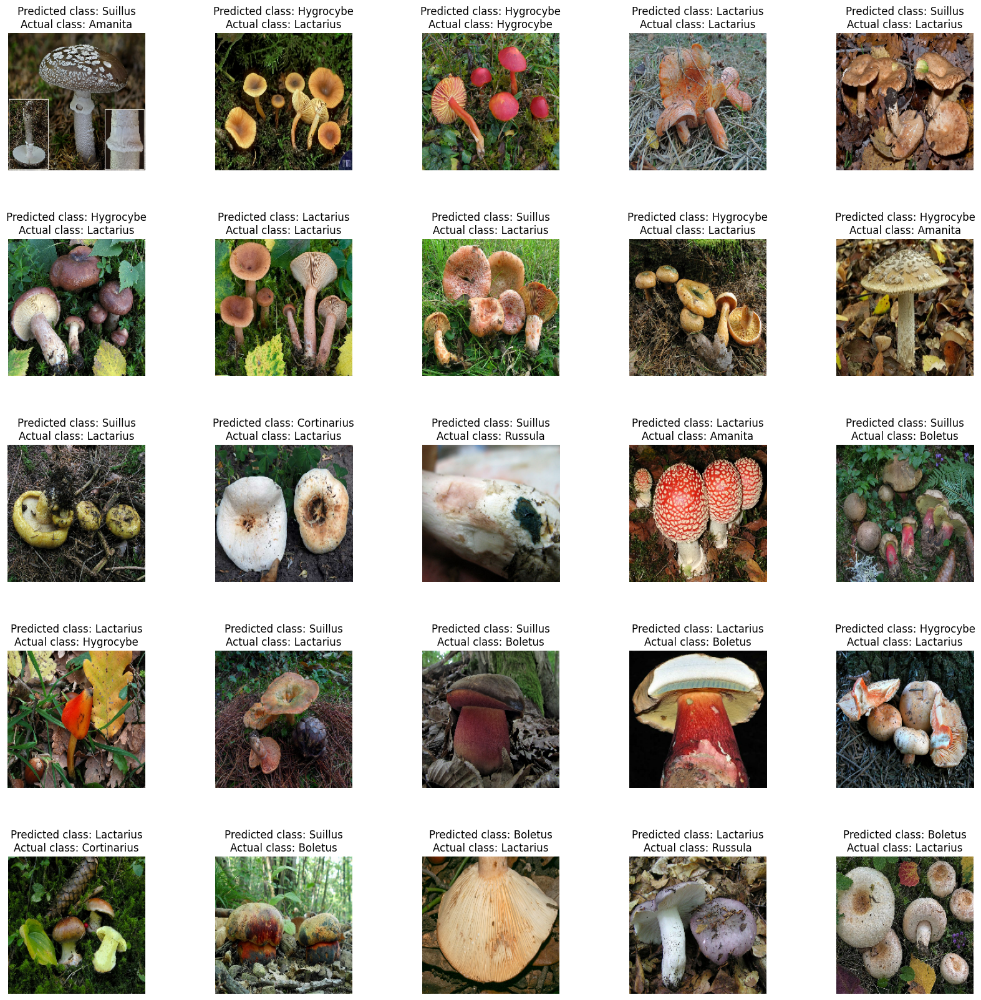

In [ ]:
predictions = eff_model.predict(validation_ds)
predicted_labels = np.argmax(predictions, axis=1)

# Print the predicted class labels
counter = 0
# Display the first 9 images alongside their predicted and actual class names in a 3x3 grid


# Display the first 9 images alongside their predicted and actual class names in a 3x3 grid
fig, axes = plt.subplots(5, 5, figsize=(20, 20))
axes = axes.ravel()

for i, (image, label) in enumerate(validation_ds.take(25)):
    image = image[0].numpy().astype("uint8")
    predicted_class = class_names[predicted_labels[i]]
    actual_class = class_names[np.argmax(label.numpy())]
    
    axes[i].imshow(image)
    axes[i].set_title(f"Predicted class: {predicted_class}\nActual class: {actual_class}")
    axes[i].axis("off")
    
plt.subplots_adjust(wspace=0.5, hspace=0.5)
plt.show()

##  Res-net
Found [here](https://www.tensorflow.org/api_docs/python/tf/keras/applications/resnet)

Paper -> https://arxiv.org/abs/1512.03385

### Making Res-net Model

171446536/171446536 [==============================] - 9s 0us/step


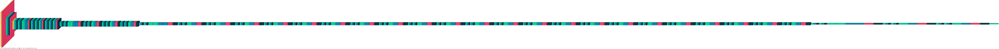

In [25]:
res_model  =  tf.keras.applications.resnet.ResNet101(weights = "imagenet",
                                                 include_top = False,
                                                 input_shape = (img_height, img_width,3),
                                                 pooling = "avg")
visualkeras.layered_view(res_model, legend= True)

In [27]:

res_model = tf.keras.models.Sequential(
    [
        res_model,
        tf.keras.layers.Dense(number_of_classes,activation = "softmax")
    ]
)


res_model.layers[0].trainable = False
res_model.compile(loss = "categorical_crossentropy",
                  optimizer = "adam",
                  metrics = ["accuracy"])
res_model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet101 (Functional)      (None, 2048)              42658176  
                                                                 
 dense_1 (Dense)             (None, 9)                 18441     
                                                                 
Total params: 42,676,617
Trainable params: 18,441
Non-trainable params: 42,658,176
_________________________________________________________________


### Training Res-Net Model 

In [ ]:
NAME = f"resnet101-{number_of_classes}-{datetime.datetime.now().strftime('%Y%m%d-%H%M%S')}"
tensorboard = TensorBoard(log_dir = f"drive/MyDrive/Champignons/logs/{NAME}")

In [ ]:
#model.fit(training_ds, validation_data=validation_ds,epochs = 3,use_multiprocessing = True)
history = res_model.fit(training_ds,validation_data = validation_ds,epochs =50, callbacks = [early_stop, reduce_lr,tensorboard],use_multiprocessing = True)

# Add tensorboard

Epoch 1/50
141/141 [==============================] - 27s 140ms/step - loss: 1.3747 - accuracy: 0.5412 - val_loss: 1.0338 - val_accuracy: 0.6468 - lr: 0.0010
Epoch 2/50
141/141 [==============================] - 17s 116ms/step - loss: 0.8643 - accuracy: 0.7042 - val_loss: 0.9485 - val_accuracy: 0.6567 - lr: 0.0010
Epoch 3/50
141/141 [==============================] - 17s 116ms/step - loss: 0.7256 - accuracy: 0.7507 - val_loss: 0.8379 - val_accuracy: 0.7091 - lr: 0.0010
Epoch 4/50
141/141 [==============================] - 17s 114ms/step - loss: 0.6256 - accuracy: 0.7841 - val_loss: 0.8997 - val_accuracy: 0.6902 - lr: 0.0010
Epoch 5/50
141/141 [==============================] - 17s 113ms/step - loss: 0.5710 - accuracy: 0.8059 - val_loss: 0.8930 - val_accuracy: 0.7010 - lr: 0.0010
Epoch 6/50
141/141 [==============================] - 17s 114ms/step - loss: 0.4960 - accuracy: 0.8334 - val_loss: 0.8651 - val_accuracy: 0.7123 - lr: 0.0010
Epoch 7/50
141/141 [==============================] 

In [ ]:
loss,accuracy = res_model.evaluate(validation_ds,verbose = 1)
print("Performace on test data: \n Loss: {} \n Accuracy: {}".format(loss, accuracy))

70/70 [==============================] - 2s 24ms/step - loss: 0.7564 - accuracy: 0.7742
Performace on test data: 
 Loss: 0.7564128041267395 
 Accuracy: 0.7741643786430359


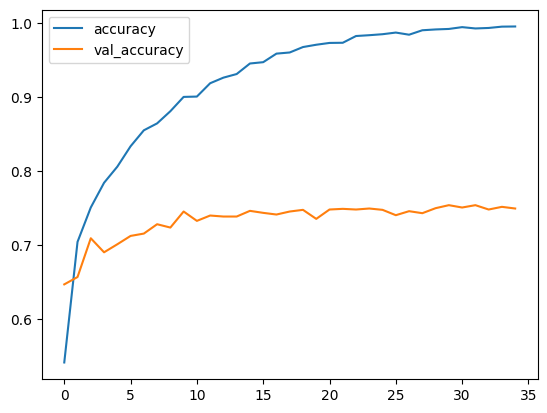

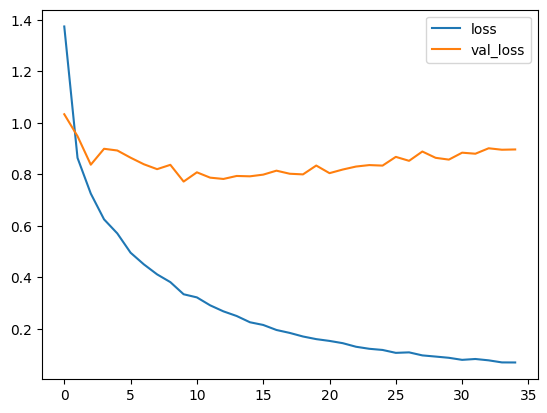

In [ ]:
history_frame  = pd.DataFrame(history.history)

history_frame.loc[:, ['accuracy', 'val_accuracy']].plot();
history_frame.loc[:, ['loss', 'val_loss']].plot();


70/70 [==============================] - 3s 20ms/step


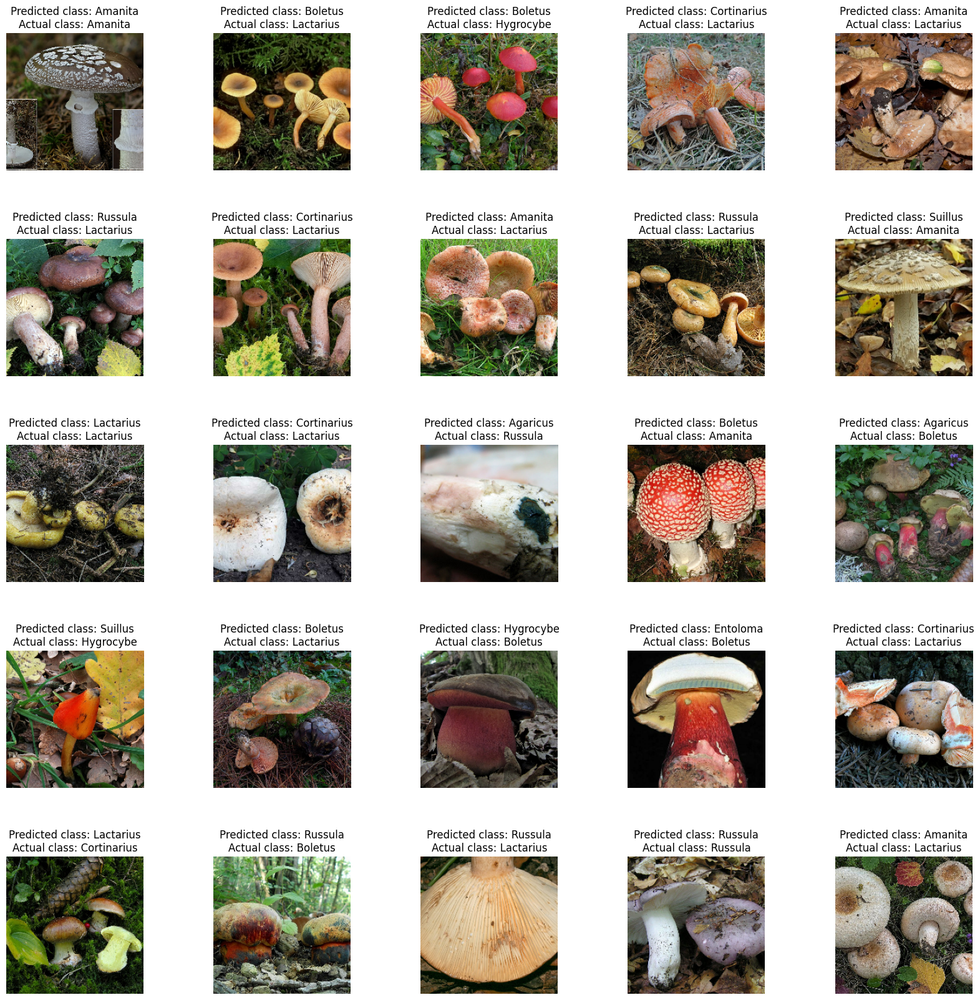

In [ ]:
predictions = res_model.predict(validation_ds)
predicted_labels = np.argmax(predictions, axis=1)

# Print the predicted class labels
counter = 0
# Display the first 9 images alongside their predicted and actual class names in a 3x3 grid



# Display the first 9 images alongside their predicted and actual class names in a 3x3 grid
fig, axes = plt.subplots(5, 5, figsize=(20, 20))
axes = axes.ravel()

for i, (image, label) in enumerate(validation_ds.take(25)):
    image = image[0].numpy().astype("uint8")
    predicted_class = class_names[predicted_labels[i]]
    actual_class = class_names[np.argmax(label.numpy())]
    
    axes[i].imshow(image)
    axes[i].set_title(f"Predicted class: {predicted_class}\nActual class: {actual_class}")
    axes[i].axis("off")
    
plt.subplots_adjust(wspace=0.5, hspace=0.5)
plt.show()

# Analysis

In [ ]:

%reload_ext tensorboard
%tensorboard --logdir "drive/MyDrive/Champignons/logs"


Reusing TensorBoard on port 6006 (pid 39191), started 0:41:38 ago. (Use '!kill 39191' to kill it.)

<IPython.core.display.Javascript object>